In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import cv2
import random
import json
from PIL import Image
import os
from torch.utils.data import Dataset, DataLoader
import torch, torchvision
import warnings
from skimage import io
import numpy as np
from albumentations.pytorch.transforms import ToTensor
import albumentations as A
import pandas as pd
from tqdm.notebook import tqdm

warnings.filterwarnings("ignore")
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
import shutil
from tqdm import tqdm
from matplotlib import pyplot as plt
import torch.optim as optim
from torch.optim import lr_scheduler
import torchvision
from torchvision import datasets, models, transforms


In [10]:
model = torch.load('/content/drive/MyDrive/face_cartonizing/generator_merged.pt')
model_scripted = torch.jit.script(model) # Export to TorchScript
model_scripted.save('/content/drive/MyDrive/face_cartonizing/generator_merged_scripted.pt') # Save

In [3]:
import torch
from torch import nn

# If there's a GPU available...
if torch.cuda.is_available():

    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")

    print('There are %d GPU(s) available.' % torch.cuda.device_count())

    print('We will use the GPU:', torch.cuda.get_device_name(0))

# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla P100-PCIE-16GB


In [4]:
def plot_images(images_for_show):
  """Строит изображение на одном графике"""
  fig = plt.figure(figsize=(16, 16))

  columns = len(images_for_show)
  rows = 1
  for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(images_for_show[i - 1])
    
  fig.subplots_adjust(wspace=0.1, hspace=0)
  plt.show()

## Creating dataloaders

In [5]:
class ImageDataset(Dataset):
    def __init__(self, df, transforms):
        self.transforms = transforms
        self.df = df

    def __len__(self):
        return len(self.df)

    
    def _load_file(self, path):
        image = cv2.imread(path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        return image

    def __getitem__(self, idx):
        now = self.df.iloc[idx]
        x = self._load_file(now['x_path'])
        y = self._load_file(now['y_path'])
        transformed = self.transforms(image=x)
        x = transformed['image']
        transformed = self.transforms(image=y)
        y = transformed['image']
        
        return x, y

In [6]:
img_size = 512

data_transforms = {
    'train': A.Compose([
              # A.RandomCrop(width=1024, height=1024),
              # A.Cutout(num_holes=50, max_h_size=40, max_w_size=40, p=0.3),
              # A.Rotate(limit=45, p=0.5),
              # A.Blur(blur_limit=10, p=0.5),
              A.Resize(img_size, img_size),
              # A.Normalize(),
              ToTensor()
          ]),
    'test': A.Compose([
              # A.RandomCrop(width=1024, height=1024),
              A.Resize(img_size, img_size),
              # A.Normalize(),
              ToTensor()
          ]),
}

In [7]:
import pickle

good_images = pickle.load(open('/content/drive/MyDrive/face_cartonizing/quality.pickle', 'rb'))
good_images = {k: v for k, v in good_images.items() if v > 0.8}
len(good_images)

8761

In [8]:
data_dir = '/content/drive/MyDrive/face_cartonizing'

x_path = os.path.join(data_dir, 'real')
y_path = os.path.join(data_dir, 'merged')


paths = []
for name in good_images.keys():
  d = {'x_path': os.path.join(x_path, name),
       'y_path': os.path.join(y_path, name)}
  paths.append(d)

df = pd.DataFrame(paths)

In [9]:
df.loc[0]['x_path']

'/content/drive/MyDrive/face_cartonizing/real/seed_964920.jpg'

In [10]:
from sklearn.model_selection import train_test_split

train_df, test_df = train_test_split(df, test_size=0.2, shuffle=True)

In [11]:
train_dataset = ImageDataset(train_df, data_transforms['train'])
test_dataset = ImageDataset(test_df, data_transforms['test'])

batch_size = 8
train_loader = DataLoader(train_dataset, batch_size=batch_size, num_workers=8, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, num_workers=8, shuffle=True)

In [12]:
# batch = train_dataset[0]
# batch[0].shape, batch[1].shape

## Model defining

In [13]:
class CNNBlock(nn.Module):
  def __init__(self, in_channels, out_channels, stride=2):
    super().__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels, out_channels, 4, stride, bias=False, padding=1, padding_mode='reflect'),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.2)
    )
  
  def forward(self, x):
    return self.conv(x)

In [14]:
class Discriminator(nn.Module):
  def __init__(self, in_channels=3, features=[64, 128, 256, 512]):
    super().__init__()
    self.initial = nn.Sequential(
        nn.Conv2d(in_channels * 2, features[0], kernel_size=4, stride=2, padding=1, padding_mode='reflect'),
        nn.LeakyReLU(0.2)
    )

    layers = []
    in_channels = features[0]
    for feature in features[1:]:
      layers.append(CNNBlock(in_channels, feature, stride=1 if feature == features[-1] else 2))
      in_channels = feature
    
    layers.append(
        nn.Conv2d(in_channels, 1, kernel_size=4, stride=1, padding=1, padding_mode='reflect'),
        # nn.Sigmoid(),
    )

    self.model = nn.Sequential(*layers)

  def forward(self, x, y):
    x = torch.cat([x, y], dim=1)
    x = self.initial(x)
    return self.model(x)

In [15]:
discriminator = Discriminator()
x = torch.rand((16, 3, img_size, img_size))
y = torch.rand((16, 3, img_size, img_size))
discriminator(x, y).shape

torch.Size([16, 1, 62, 62])

In [16]:
class Block(nn.Module):
  def __init__(self, in_channels, out_channels, down, use_relu=True, use_dropout=False):
    super().__init__()
    if down:
      layer = nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False, padding_mode='reflect')
    else:
      layer = nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False)
    
    self.conv = nn.Sequential(
        layer,
        nn.BatchNorm2d(out_channels),
        nn.ReLU() if use_relu else nn.LeakyReLU(0.2)
    )
    
    self.dropout = nn.Dropout(0.5)
    self.use_dropout = use_dropout

  def forward(self, x):
    x = self.conv(x)
    return self.dropout(x) if self.use_dropout else x

In [17]:
class Generator(nn.Module):
  def __init__(self, in_channels=3, features=64):
    super().__init__()
    self.initial = nn.Sequential(
        nn.Conv2d(in_channels, features, kernel_size=4, stride=2, padding=1, padding_mode='reflect'),
        nn.LeakyReLU(0.2)
    ) # 256

    self.down1 = Block(features, features * 2, down=True, use_relu=False, use_dropout=False) # 128
    self.down2 = Block(features * 2, features * 4, down=True, use_relu=False, use_dropout=False) # 64
    self.down3 = Block(features * 4, features * 8, down=True, use_relu=False, use_dropout=False) # 32
    self.down4 = Block(features * 8, features * 8, down=True, use_relu=False, use_dropout=False) # 16
    self.down5 = Block(features * 8, features * 8, down=True, use_relu=False, use_dropout=False) # 8
    self.down6 = Block(features * 8, features * 8, down=True, use_relu=False, use_dropout=False) # 4
    self.down7 = Block(features * 8, features * 8, down=True, use_relu=False, use_dropout=False) # 2

    self.bottleneck = nn.Sequential(
        nn.Conv2d(features * 8, features * 8, 4, 2, 1, padding_mode='reflect'), # 1
        nn.ReLU()
    )

    self.up1 = Block(features * 8, features * 8, down=False, use_relu=True, use_dropout=True)
    self.up2 = Block(features * 8 * 2, features * 8, down=False, use_relu=True, use_dropout=True)
    self.up3 = Block(features * 8 * 2, features * 8, down=False, use_relu=True, use_dropout=True)
    self.up4 = Block(features * 8 * 2, features * 8, down=False, use_relu=True, use_dropout=True)
    self.up5 = Block(features * 8 * 2, features * 8, down=False, use_relu=True, use_dropout=False)
    self.up6 = Block(features * 8 * 2, features * 4, down=False, use_relu=True, use_dropout=False)
    self.up7 = Block(features * 4 * 2, features * 2, down=False, use_relu=True, use_dropout=False)
    self.up8 = Block(features * 2 * 2, features, down=False, use_relu=True, use_dropout=False)

    self.final_up = nn.Sequential(
        nn.ConvTranspose2d(features * 2, in_channels, 4, 2, 1),
        # nn.Tanh()
        nn.Sigmoid()
    )

  def forward(self, x):
    d1 = self.initial(x)
    d2 = self.down1(d1)
    d3 = self.down2(d2)
    d4 = self.down3(d3)
    d5 = self.down4(d4)
    d6 = self.down5(d5)
    d7 = self.down6(d6)
    d8 = self.down7(d7)

    bottleneck = self.bottleneck(d8)

    up1 = self.up1(bottleneck)
    up2 = self.up2(torch.cat([up1, d8], 1))
    up3 = self.up3(torch.cat([up2, d7], 1))
    up4 = self.up4(torch.cat([up3, d6], 1))
    up5 = self.up5(torch.cat([up4, d5], 1))
    up6 = self.up6(torch.cat([up5, d4], 1))
    up7 = self.up7(torch.cat([up6, d3], 1))
    up8 = self.up8(torch.cat([up7, d2], 1))

    return self.final_up(torch.cat([up8, d1], 1))

In [18]:
generator = Generator()
x = torch.rand((16, 3, img_size, img_size))
generator(x).shape

torch.Size([16, 3, 512, 512])

## Training loops

In [19]:
def show_random_predict(model, loader):
  batch = next(iter(loader))
  x, y = batch[0].to(device), batch[1].to(device)
  fake = model['generator'](x)
  fake = torch.moveaxis(fake, 1, -1).detach().cpu().numpy()[:2]
  real_cartoon = torch.moveaxis(y, 1, -1).detach().cpu().numpy()[:2]
  real = torch.moveaxis(x, 1, -1).detach().cpu().numpy()[:2]
  plot_images(np.concatenate([real, real_cartoon, fake], axis=0))

In [20]:
def train_epoch(model, batch_gen, bce, l1_loss, optimizer, is_train = True) :
    losses = {'D_real': 0.0, 'D_fake': 0.0}
    count = 0
    model['generator'].train(is_train)
    model['discriminator'].train(is_train)

    for x, y in tqdm(batch_gen) :
        # print(input.shape, labels)
        x = x.to(device)
        y = y.to(device)
        count += x.shape[0]

        with torch.set_grad_enabled(is_train):
            # fit discriminator
            y_fake = model['generator'](x)
            # print(y_fake.shape, x.shape, y.shape)
            D_real = model['discriminator'](x, y)
            D_fake = model['discriminator'](x, y_fake)
            D_real_loss = bce(D_real, torch.ones_like(D_real))
            D_fake_loss = bce(D_fake, torch.zeros_like(D_real))
            D_loss = (D_real_loss + D_fake_loss) / 2

            losses['D_real'] += D_real_loss.item()
            losses['D_fake'] += D_fake_loss.item()
            
            if is_train :
                optimizer['discriminator'].zero_grad()
                D_loss.backward(retain_graph=True)
                optimizer['discriminator'].step()

            # fit generator
            # y_fake = model['generator'](x)
            D_fake = model['discriminator'](x, y_fake)
            G_loss = bce(D_fake, torch.ones_like(D_fake))
            L1_loss = l1_loss(y_fake, y) * 100
            G_loss += L1_loss

            if is_train :
                optimizer['generator'].zero_grad()
                G_loss.backward()
                optimizer['generator'].step()

    for k in losses.keys():
      losses[k] /= count
    return losses

In [21]:
def train_model(model, train_loader, test_loader, criterion, l1_loss, optimizer, scheduler, num_epochs, verbose=True):
    loader = {'train': train_loader, 'test': test_loader}
    loss_history = {'train': [], 'test': []}

    for epoch in range(num_epochs):
        if verbose:
            print('Epoch {}/{}'.format(epoch, num_epochs - 1))
            print('-' * 10)

        for phase in ['train']:
            epoch_loss = train_epoch(model, loader[phase], criterion, l1_loss, optimizer, phase == 'train')
            if verbose:
                print('{} Loss: {}'.format(phase, epoch_loss))
            loss_history[phase].append(epoch_loss)

        if scheduler is not None:
          scheduler.step()
        
        # if epoch % 5 == 0:
        #   print('make checkpoint')
        #   torch.save(model['generator'], '/content/drive/MyDrive/face_cartonizing/generator_{}.pt'.format(epoch))
        #   torch.save(model['discriminator'], '/content/drive/MyDrive/face_cartonizing/discriminator_{}.pt'.format(epoch))

        torch.save(model['generator'], '/content/drive/MyDrive/face_cartonizing/generator_merged.pt')
        torch.save(model['discriminator'], '/content/drive/MyDrive/face_cartonizing/discriminator_merged.pt')

        if verbose:
            show_random_predict(model, test_loader)
            print()

    return loss_history

In [31]:
model = {
    "discriminator": Discriminator().to(device),
    "generator": Generator().to(device)
}

In [22]:
model = {
    "discriminator": torch.load('/content/drive/MyDrive/face_cartonizing/discriminator_merged.pt', map_location=device),
    "generator": torch.load('/content/drive/MyDrive/face_cartonizing/generator_merged.pt', map_location=device)
}

In [23]:
optimizer = {
    "discriminator": torch.optim.Adam(model['discriminator'].parameters(), lr=3e-4, betas=(0.5, 0.999)),
    "generator": torch.optim.Adam(model['generator'].parameters(), lr=3e-4, betas=(0.5, 0.999)),
}

bce = nn.BCEWithLogitsLoss().to(device)
l1_loss = nn.L1Loss()

### Train pix2pix on merged dataset

Epoch 0/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.35it/s]


train Loss: {'D_real': 0.07651969968217966, 'D_fake': 0.07506317836253747}


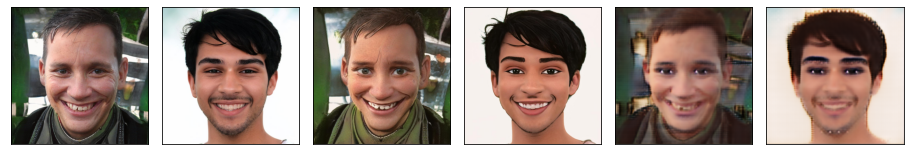


Epoch 1/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.34it/s]


train Loss: {'D_real': 0.0801189104148259, 'D_fake': 0.07880234103394698}


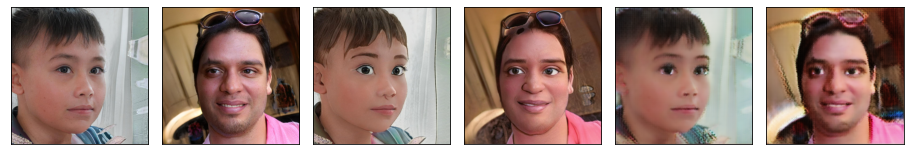


Epoch 2/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08184957311841655, 'D_fake': 0.07998714411682258}


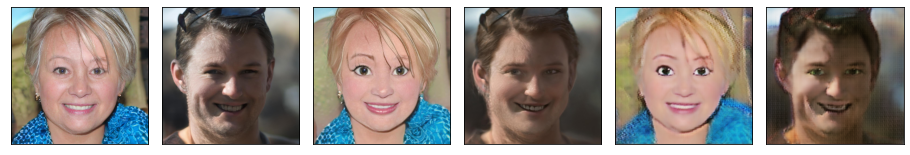


Epoch 3/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.34it/s]


train Loss: {'D_real': 0.081741426735436, 'D_fake': 0.0807472446520885}


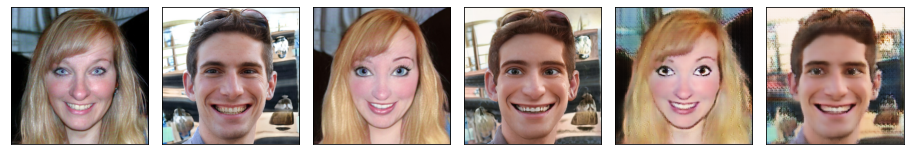


Epoch 4/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.35it/s]


train Loss: {'D_real': 0.08158095858855062, 'D_fake': 0.08111411343503012}


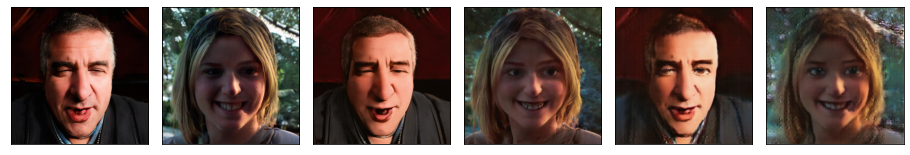


Epoch 5/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.0813723362442191, 'D_fake': 0.08116319519148706}


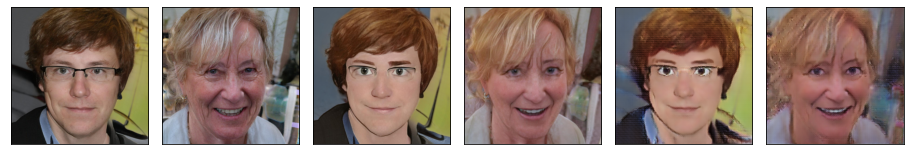


Epoch 6/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08153091740398986, 'D_fake': 0.08122142633533777}


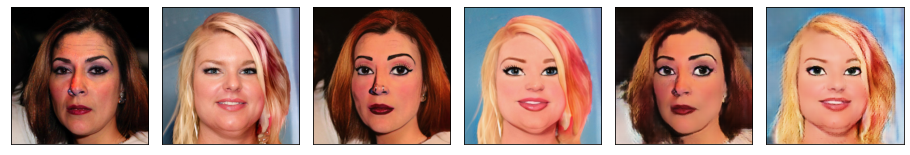


Epoch 7/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.0812762231102477, 'D_fake': 0.08122687598001467}


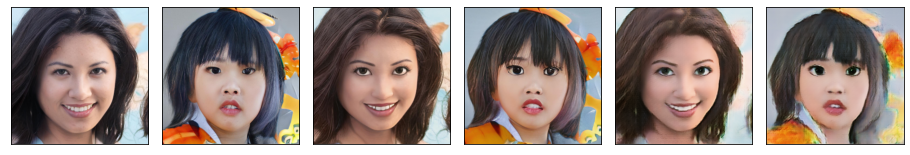


Epoch 8/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.0814405292204526, 'D_fake': 0.0811068534247203}


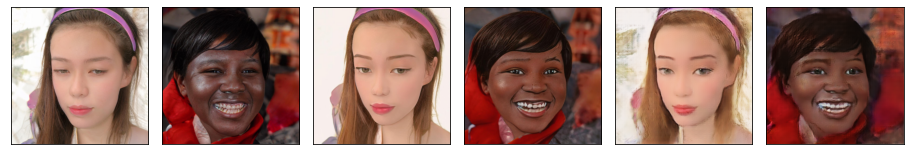


Epoch 9/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.35it/s]


train Loss: {'D_real': 0.08150263591860868, 'D_fake': 0.08125870957222159}


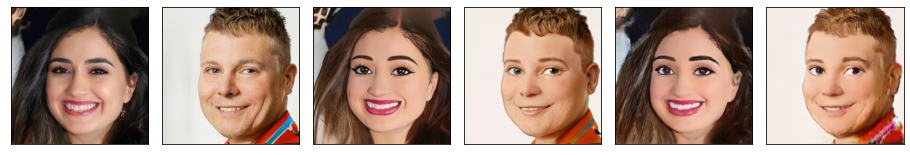


Epoch 10/39
----------


100%|██████████| 876/876 [10:52<00:00,  1.34it/s]


train Loss: {'D_real': 0.0814050343461743, 'D_fake': 0.08120139666565068}


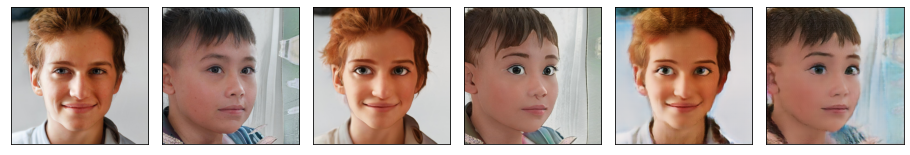


Epoch 11/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.35it/s]


train Loss: {'D_real': 0.0813046861652574, 'D_fake': 0.08125144202202626}


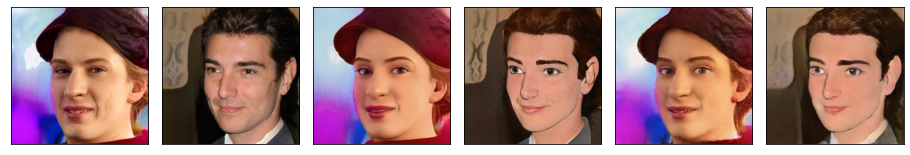


Epoch 12/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08141825816139034, 'D_fake': 0.08108867741653432}


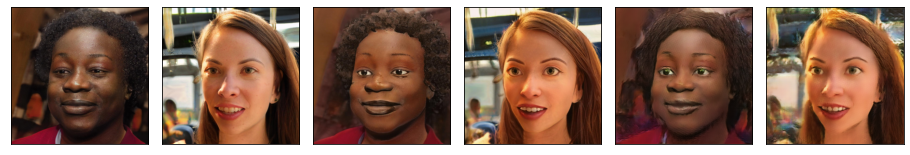


Epoch 13/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08132349751617539, 'D_fake': 0.08101642672312723}


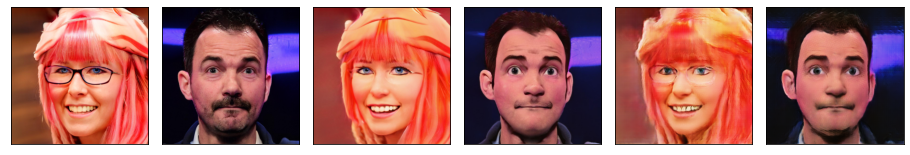


Epoch 14/39
----------


100%|██████████| 876/876 [10:51<00:00,  1.35it/s]


train Loss: {'D_real': 0.08123148746839533, 'D_fake': 0.08085430401577252}


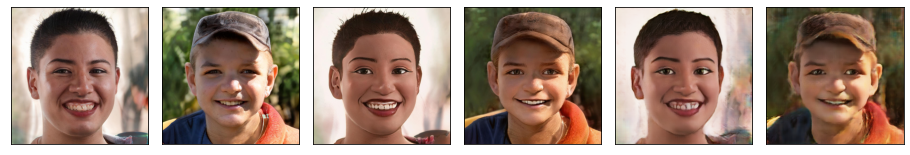


Epoch 15/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08231878449681075, 'D_fake': 0.08217202565849643}


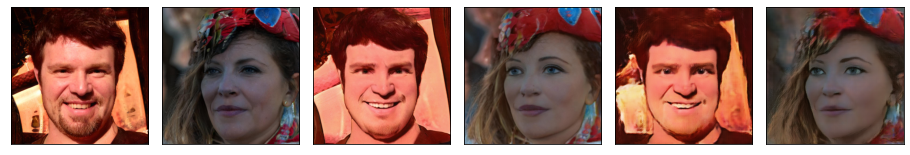


Epoch 16/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08087659353330799, 'D_fake': 0.08062791136055164}


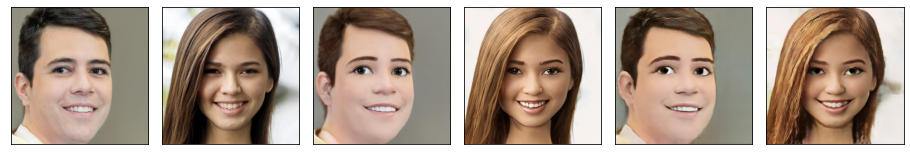


Epoch 17/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07694624295908975, 'D_fake': 0.07696584137964603}


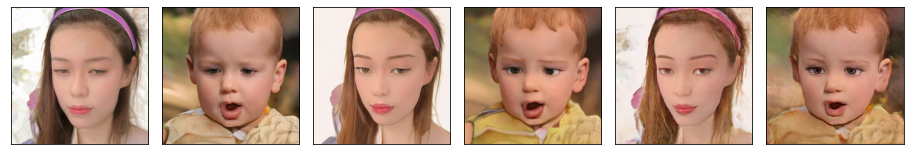


Epoch 18/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07745668376459991, 'D_fake': 0.07755425682112779}


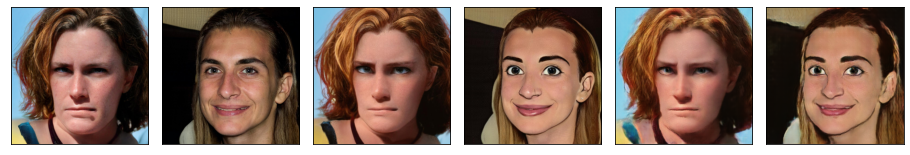


Epoch 19/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07633322455652364, 'D_fake': 0.0765699689833609}


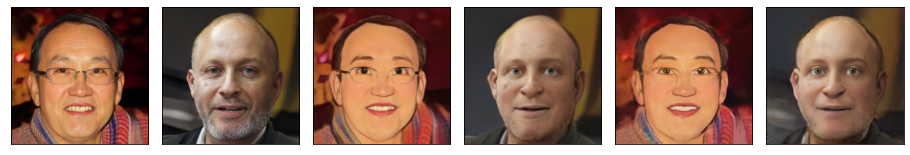


Epoch 20/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07044807553172247, 'D_fake': 0.0712495219668365}


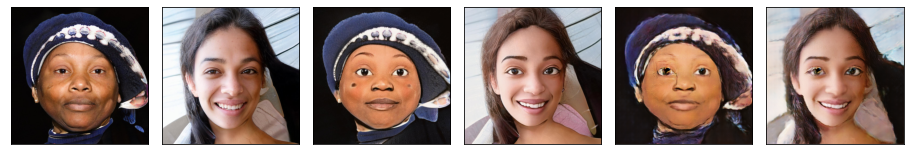


Epoch 21/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.0708377119451421, 'D_fake': 0.07115821712214465}


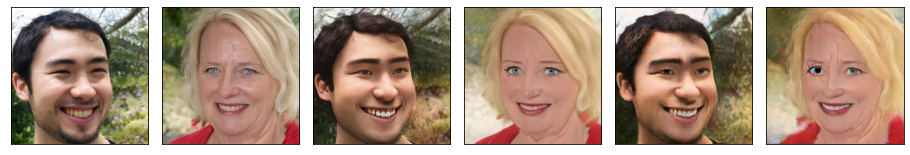


Epoch 22/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07024458016494298, 'D_fake': 0.07025717328128205}


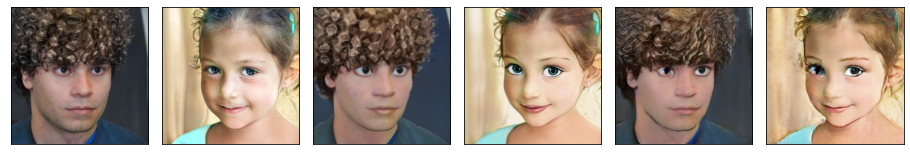


Epoch 23/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.07392397883441724, 'D_fake': 0.0736328757083103}


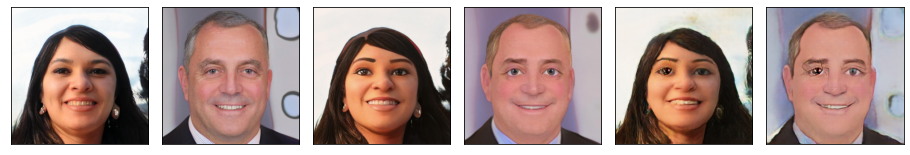


Epoch 24/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.0710054582631275, 'D_fake': 0.07066504294626823}


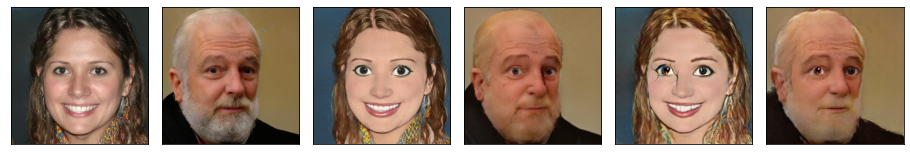


Epoch 25/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.07219288835820814, 'D_fake': 0.0717244311767422}


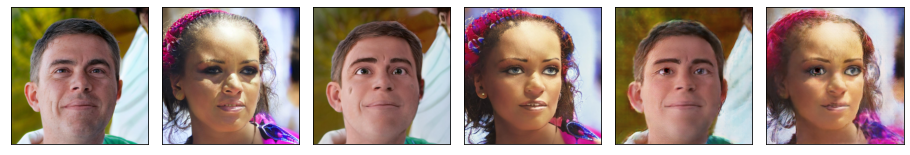


Epoch 26/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07883848671558989, 'D_fake': 0.0789309862584352}


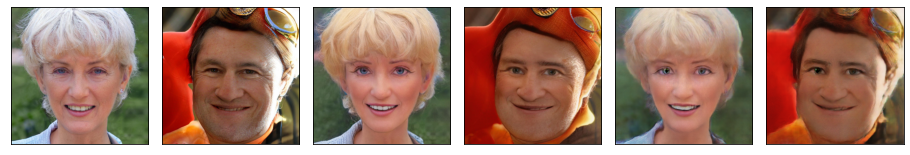


Epoch 27/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07917187307625329, 'D_fake': 0.0785533951501868}


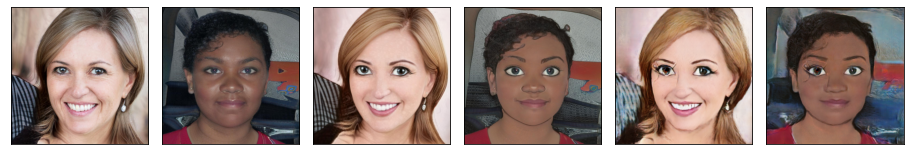


Epoch 28/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07393762054449143, 'D_fake': 0.07395599438430375}


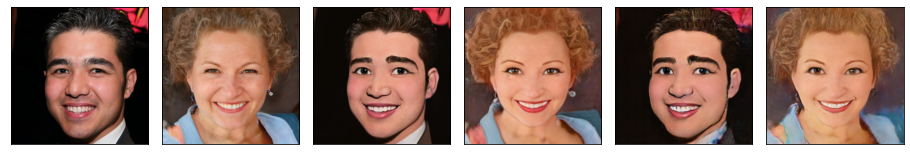


Epoch 29/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07731508342208995, 'D_fake': 0.07711271827266505}


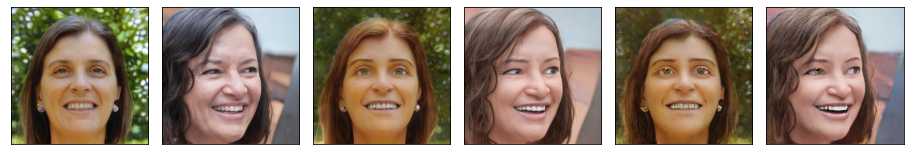


Epoch 30/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07085490080668297, 'D_fake': 0.07097695635197913}


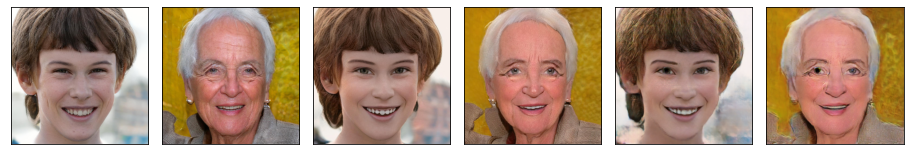


Epoch 31/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.08101752624298407, 'D_fake': 0.08041635560526696}


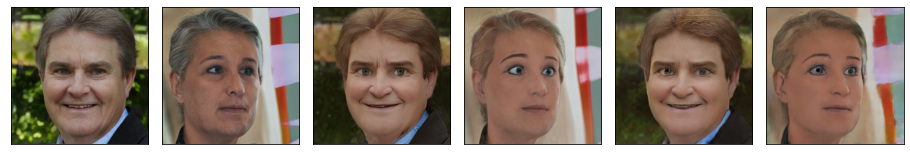


Epoch 32/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07560483937164487, 'D_fake': 0.07523506889587532}


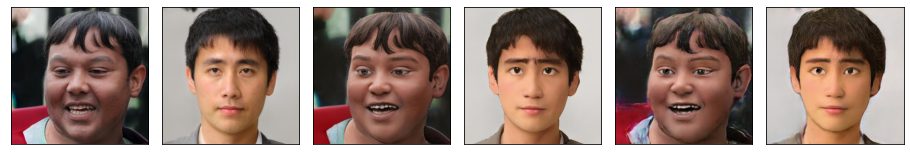


Epoch 33/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.071504720856678, 'D_fake': 0.0713057936335059}


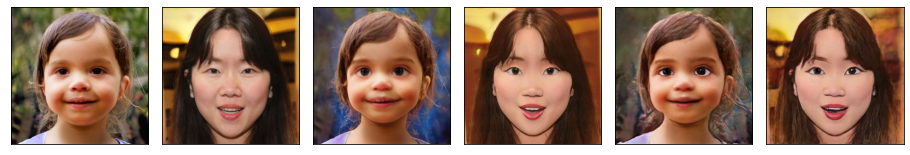


Epoch 34/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.0799535210627093, 'D_fake': 0.08034284848328595}


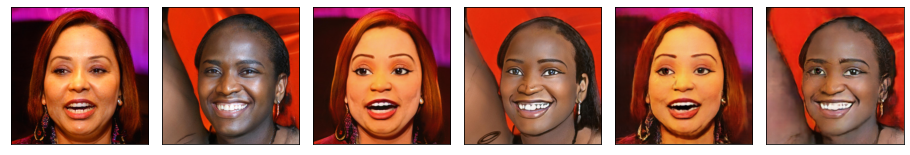


Epoch 35/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07213277211965627, 'D_fake': 0.07195963001635657}


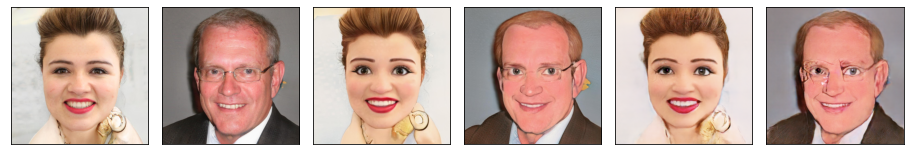


Epoch 36/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.07940910715762883, 'D_fake': 0.07895317110211746}


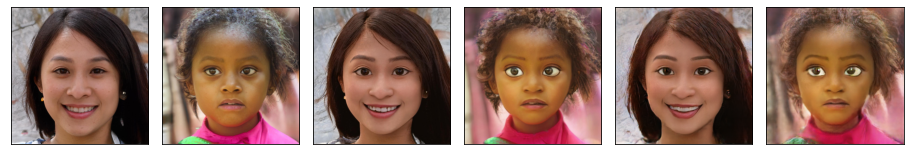


Epoch 37/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07452840338031587, 'D_fake': 0.07470197750884852}


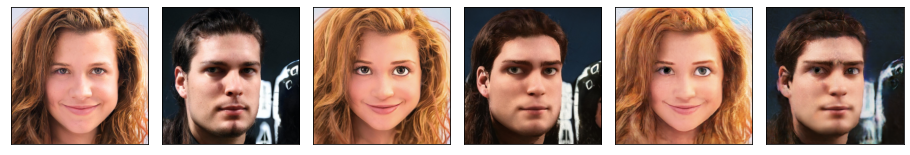


Epoch 38/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07049543430952177, 'D_fake': 0.07029210944706786}


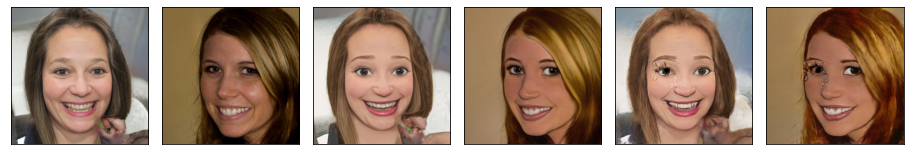


Epoch 39/39
----------


100%|██████████| 876/876 [10:50<00:00,  1.35it/s]


train Loss: {'D_real': 0.07548857687177248, 'D_fake': 0.07550761479348557}


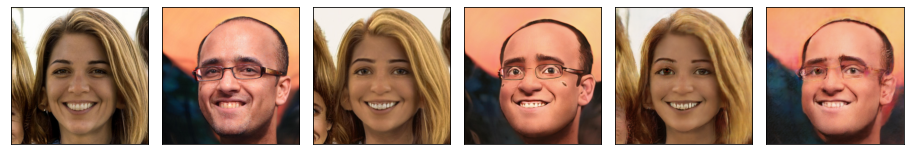

In [33]:
loss_history, cer_history = train_model(model, train_loader, test_loader, bce, l1_loss, optimizer, None, 40)

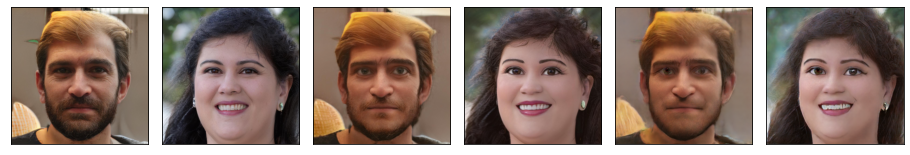

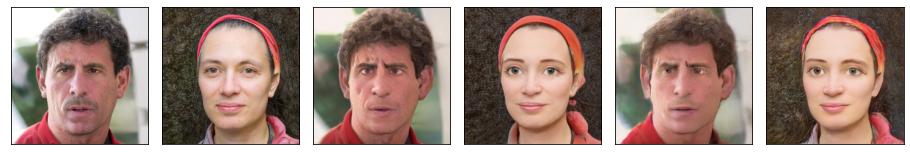

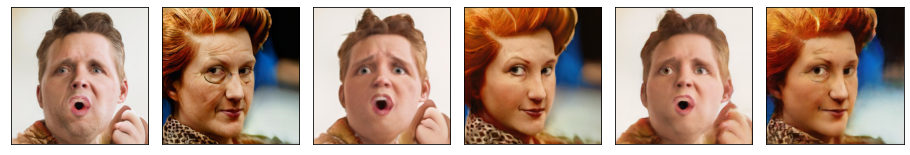

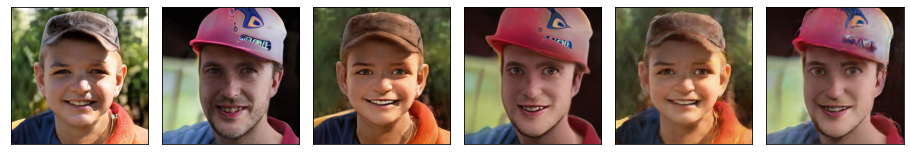

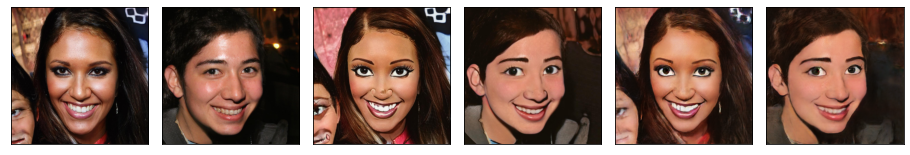

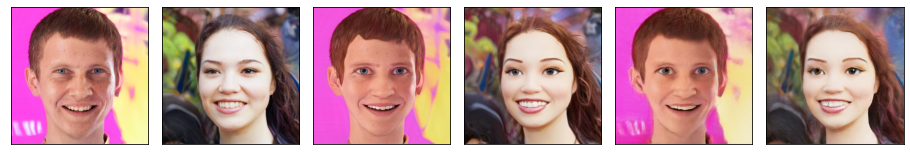

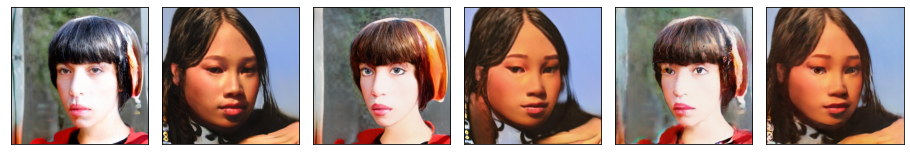

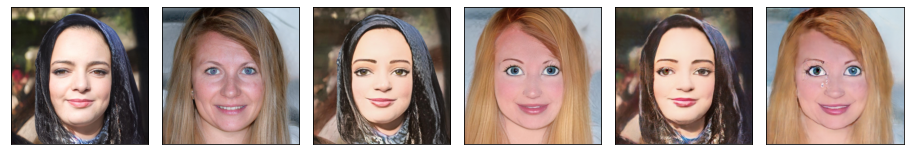

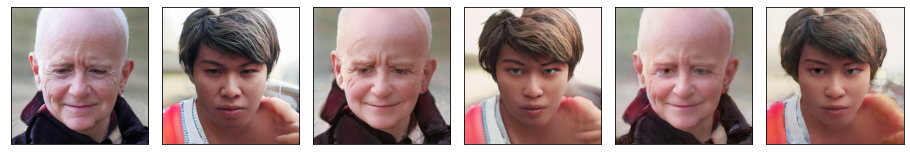

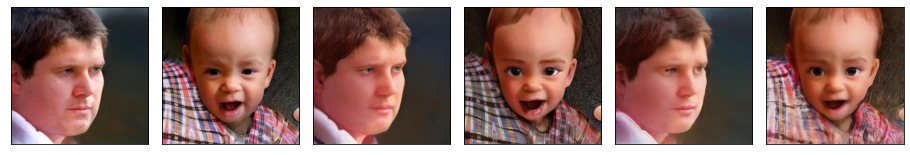

In [34]:
for i in range(10):
  show_random_predict(model, test_loader)

Epoch 0/39
----------


100%|██████████| 876/876 [14:27<00:00,  1.01it/s]


train Loss: {'D_real': 0.07246092063923405, 'D_fake': 0.07204341562677465}


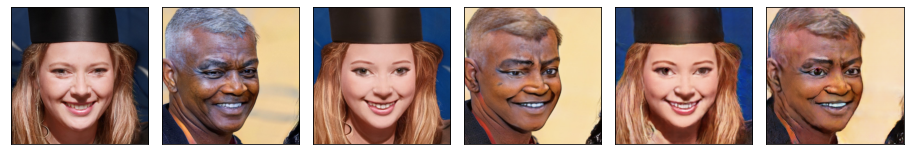


Epoch 1/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07111629551131976, 'D_fake': 0.07075268021874027}


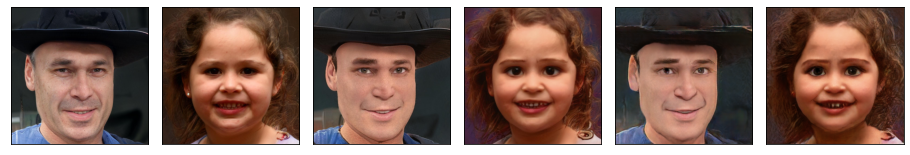


Epoch 2/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07378091407752677, 'D_fake': 0.07351062558038526}


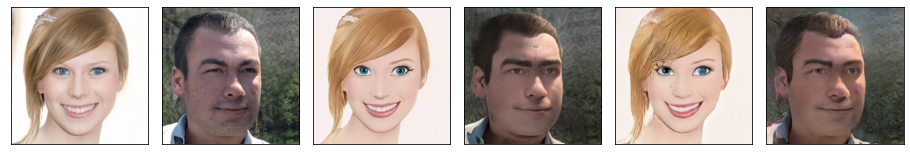


Epoch 3/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07477525434962827, 'D_fake': 0.07477768092335427}


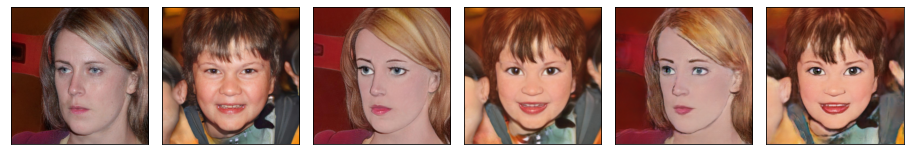


Epoch 4/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06857110173590311, 'D_fake': 0.06832839932173626}


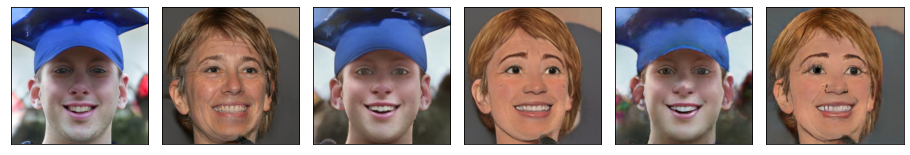


Epoch 5/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07784450627633765, 'D_fake': 0.07688750687680423}


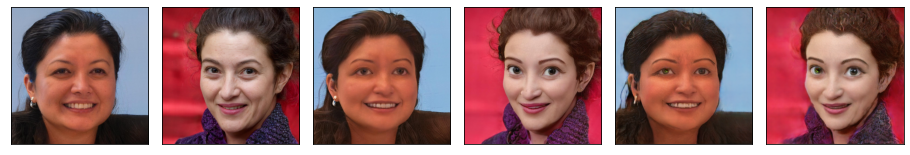


Epoch 6/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06777856465148395, 'D_fake': 0.06771821714937687}


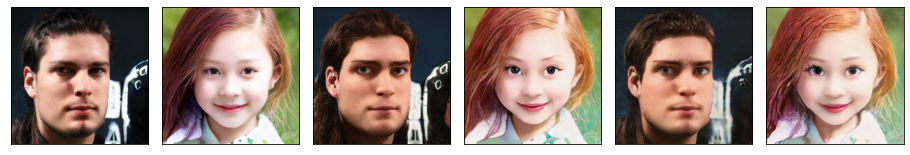


Epoch 7/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.0713125355201497, 'D_fake': 0.07075703830232835}


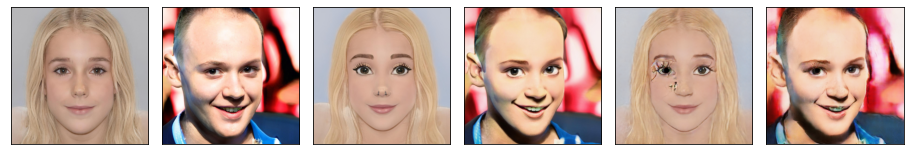


Epoch 8/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07542343768312439, 'D_fake': 0.0742016469115672}


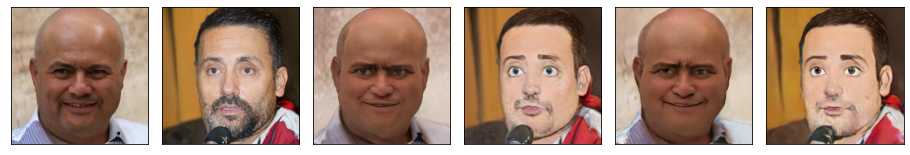


Epoch 9/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06719828641773563, 'D_fake': 0.06690694026853124}


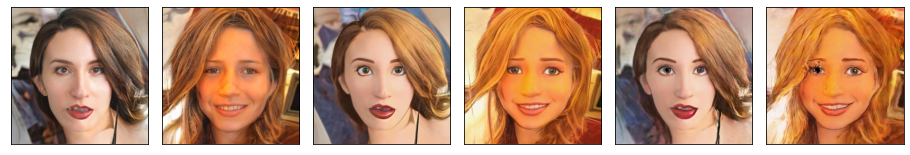


Epoch 10/39
----------


100%|██████████| 876/876 [10:47<00:00,  1.35it/s]


train Loss: {'D_real': 0.07259006692377264, 'D_fake': 0.07249343967635065}


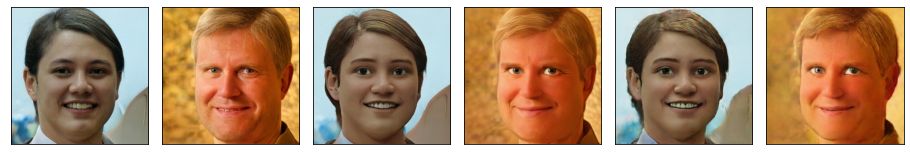


Epoch 11/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.0691478550880637, 'D_fake': 0.06869453272875824}


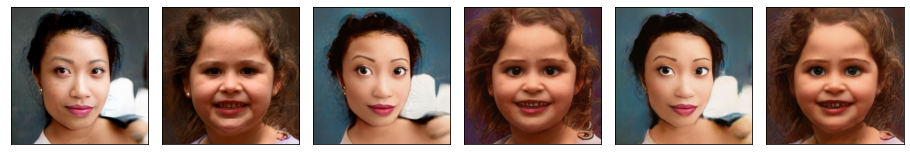


Epoch 12/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06992209897712554, 'D_fake': 0.06954014249630783}


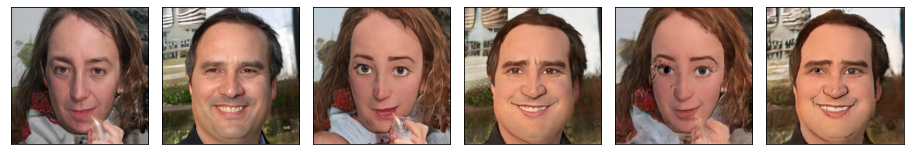


Epoch 13/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07028292729965832, 'D_fake': 0.07004198982257005}


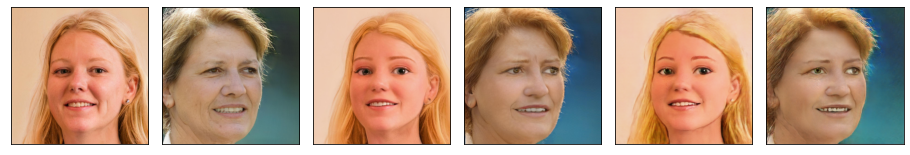


Epoch 14/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.07536319813150998, 'D_fake': 0.07503624716943734}


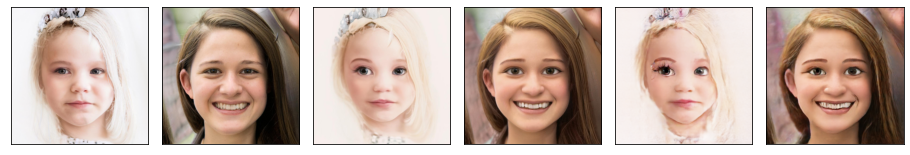


Epoch 15/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.06363650977603036, 'D_fake': 0.06364780746094167}


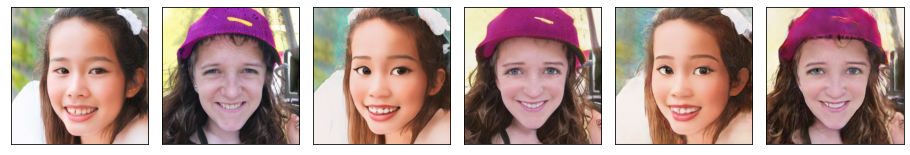


Epoch 16/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06859921440099405, 'D_fake': 0.06816015183206937}


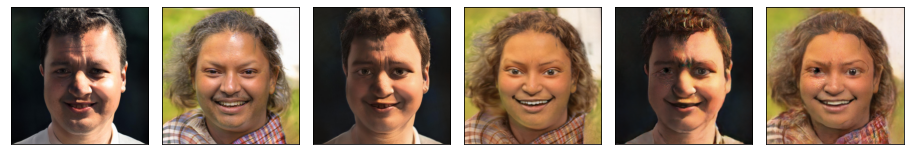


Epoch 17/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.05939230548970605, 'D_fake': 0.059244269081476446}


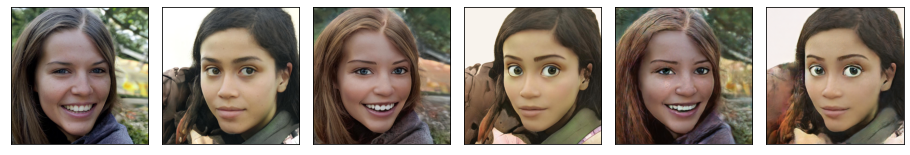


Epoch 18/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06885202715841024, 'D_fake': 0.06853269005713125}


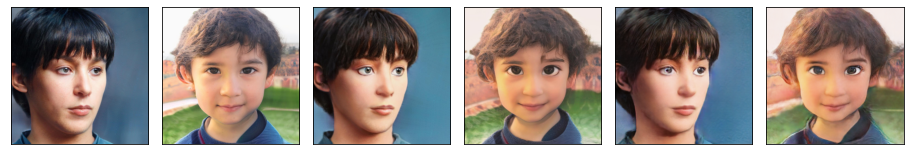


Epoch 19/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.058201971740279024, 'D_fake': 0.05763174638738983}


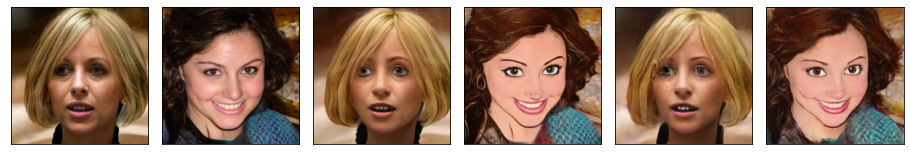


Epoch 20/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.06259210101864619, 'D_fake': 0.061504027987490134}


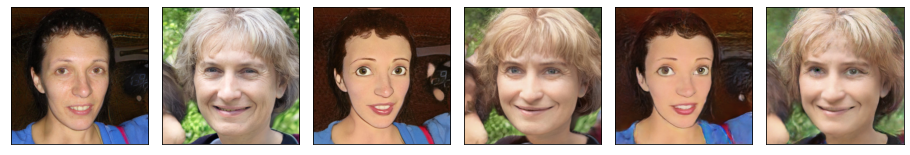


Epoch 21/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.05608226556956054, 'D_fake': 0.05559578934444123}


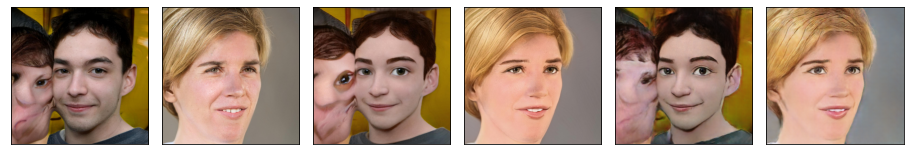


Epoch 22/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.061774327594055434, 'D_fake': 0.061758032636334226}


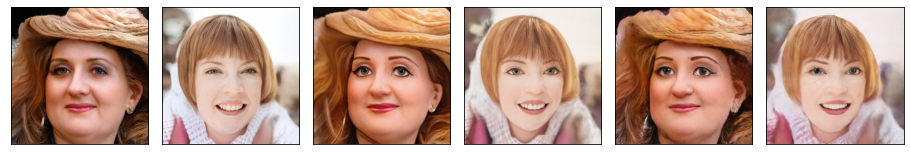


Epoch 23/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.049970310037322004, 'D_fake': 0.04945015601630931}


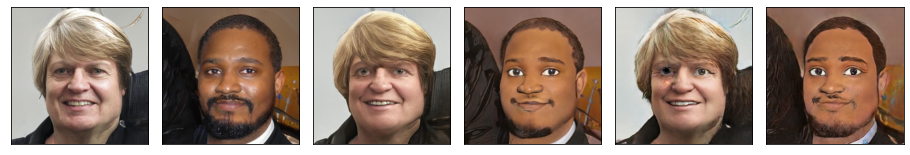


Epoch 24/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.044931893679207045, 'D_fake': 0.044729066017555864}


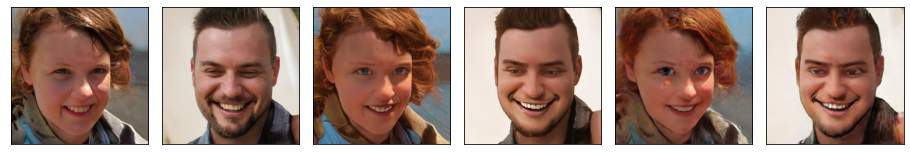


Epoch 25/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.05695579099079773, 'D_fake': 0.057316004537836945}


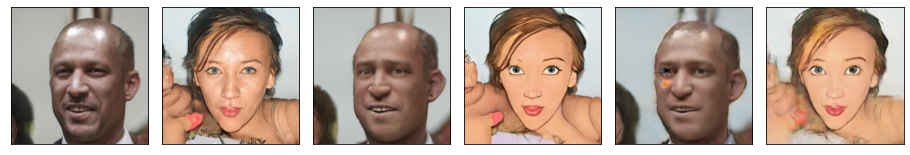


Epoch 26/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.049704479053616524, 'D_fake': 0.04892173124031806}


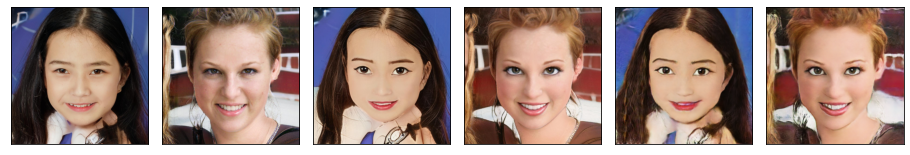


Epoch 27/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.04620230587286509, 'D_fake': 0.04452784140020201}


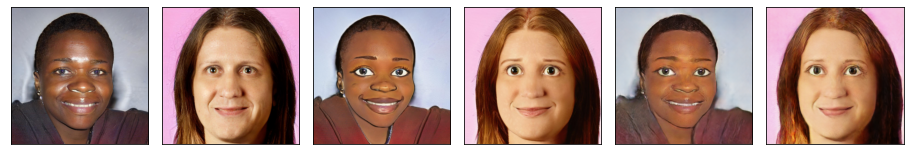


Epoch 28/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.04439240236438122, 'D_fake': 0.042936421057409246}


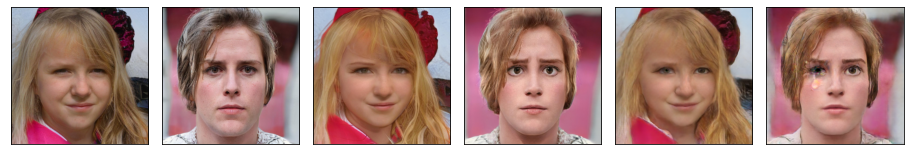


Epoch 29/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.04234967941482611, 'D_fake': 0.04181127609620211}


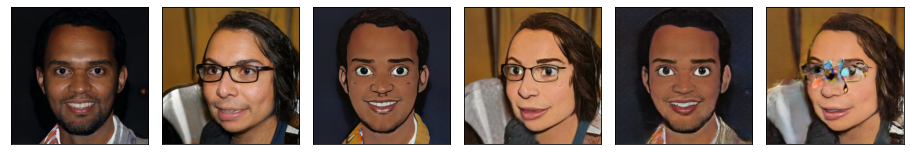


Epoch 30/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.037356712050458464, 'D_fake': 0.03653963461872318}


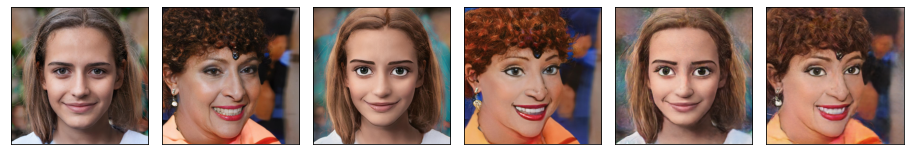


Epoch 31/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.05260291425553767, 'D_fake': 0.051175112943441424}


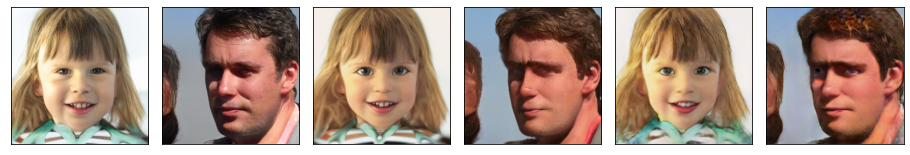


Epoch 32/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.055543863120662645, 'D_fake': 0.05331832172346969}


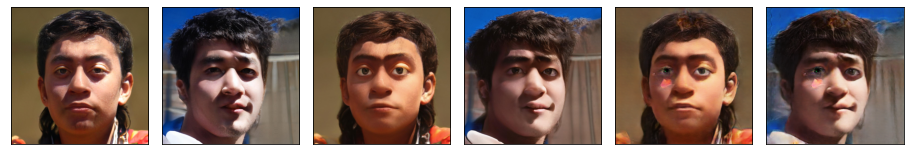


Epoch 33/39
----------


100%|██████████| 876/876 [10:49<00:00,  1.35it/s]


train Loss: {'D_real': 0.038526287262373685, 'D_fake': 0.037447317181788724}


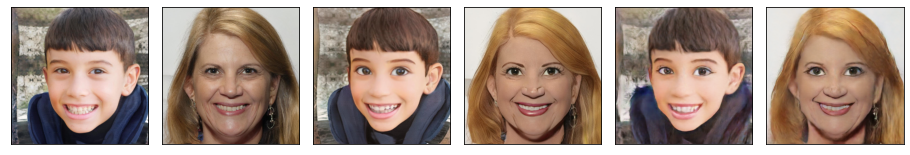


Epoch 34/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.033932437228060705, 'D_fake': 0.03266911639034063}


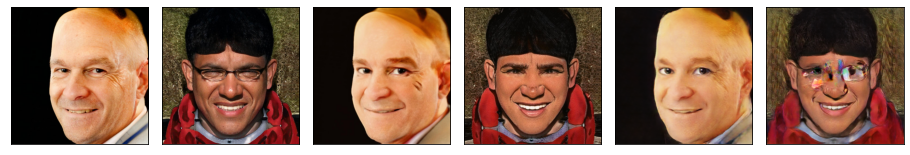


Epoch 35/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.055990309100470516, 'D_fake': 0.05222020996575027}


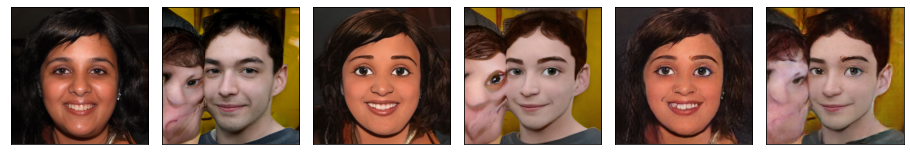


Epoch 36/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.038547027111372416, 'D_fake': 0.037616329732484965}


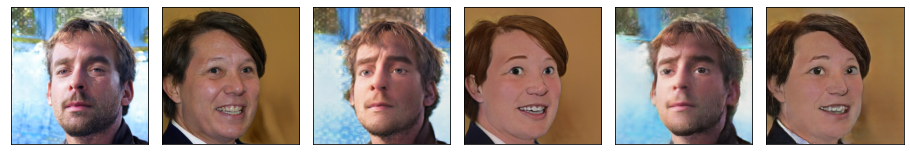


Epoch 37/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.047213084157981554, 'D_fake': 0.045314541093730815}


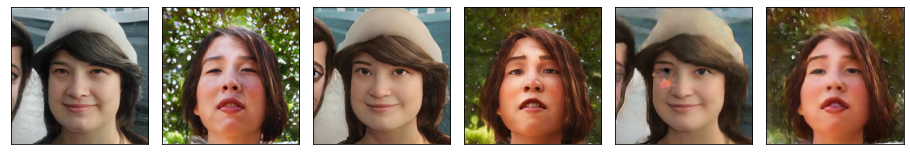


Epoch 38/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.03664557359842626, 'D_fake': 0.036005827124904605}


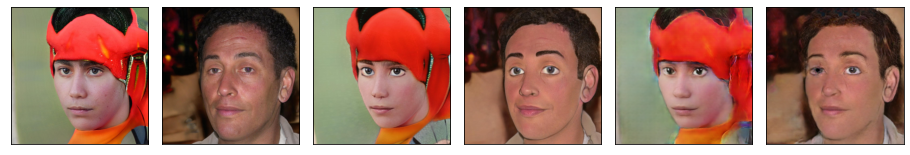


Epoch 39/39
----------


100%|██████████| 876/876 [10:48<00:00,  1.35it/s]


train Loss: {'D_real': 0.05024756516327818, 'D_fake': 0.04654612719080279}


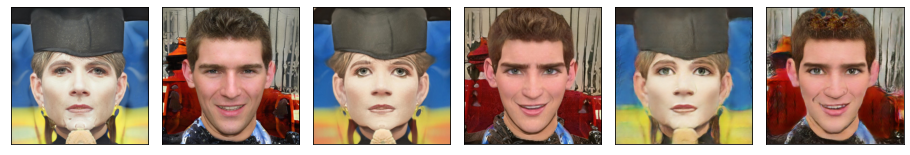

In [24]:
loss_history, cer_history = train_model(model, train_loader, test_loader, bce, l1_loss, optimizer, None, 40)

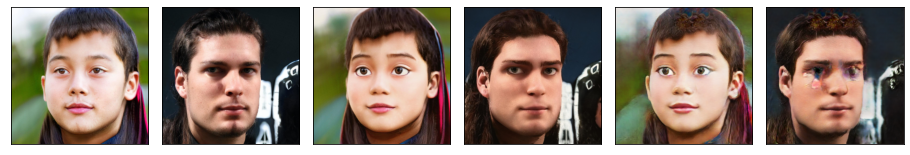

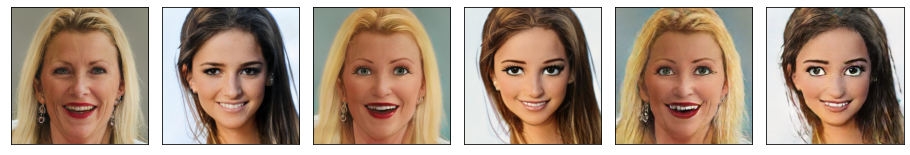

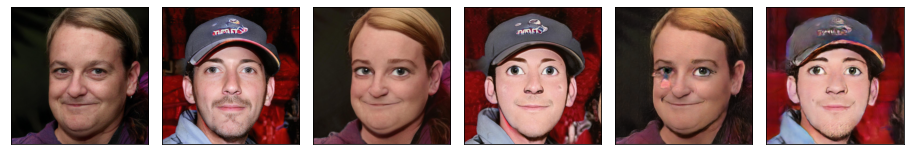

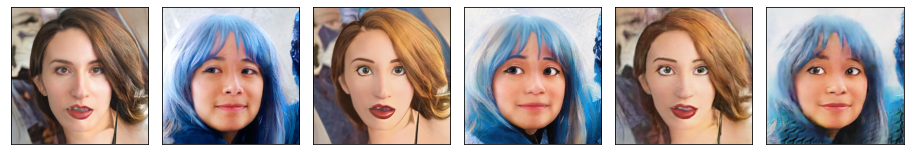

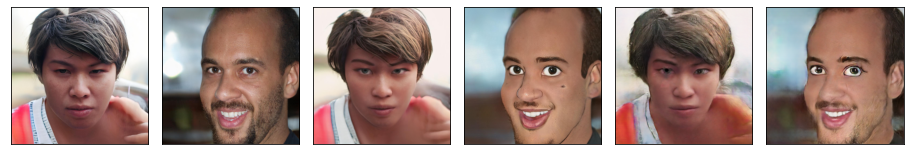

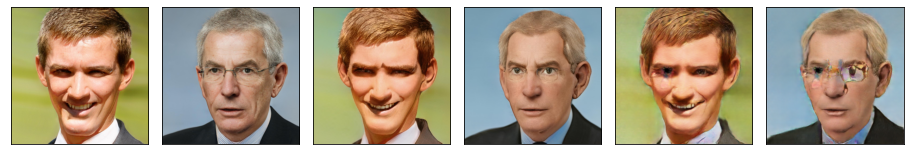

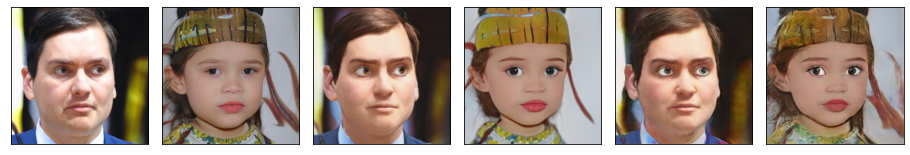

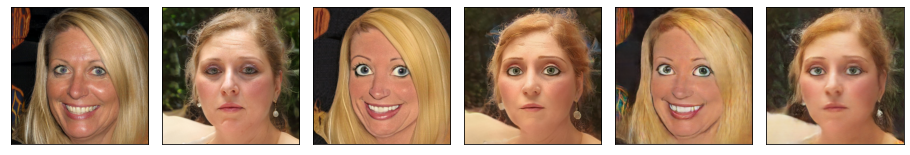

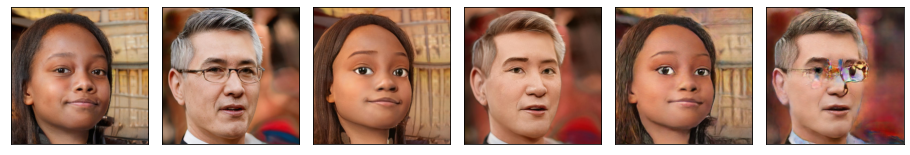

In [25]:
for i in range(10):
  show_random_predict(model, test_loader)

### Train pix2pix on merged-strong dataset

Epoch 0/39
----------


100%|██████████| 876/876 [16:28<00:00,  1.13s/it]


train Loss: {'D_real': 0.07595130960886541, 'D_fake': 0.07294379321849781}


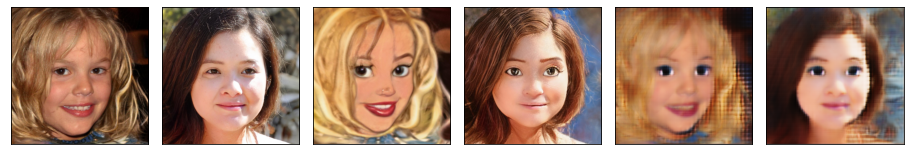


Epoch 1/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07781745737831036, 'D_fake': 0.07551610142685745}


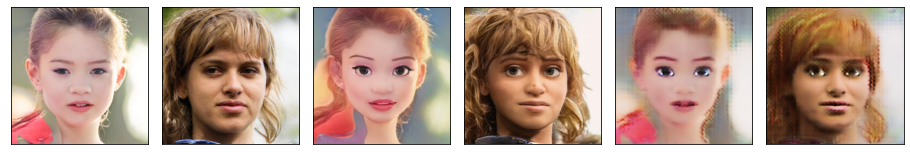


Epoch 2/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07883647335459347, 'D_fake': 0.0764871729775991}


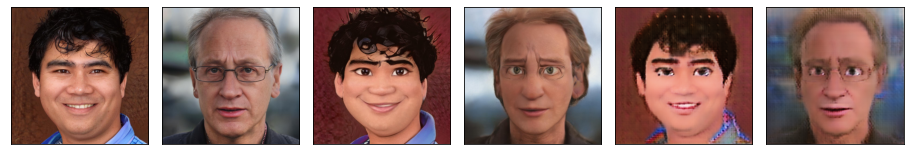


Epoch 3/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07908239361051828, 'D_fake': 0.07730053001632022}


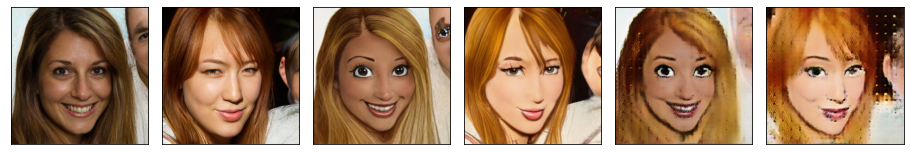


Epoch 4/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07954959853947775, 'D_fake': 0.07775810068541261}


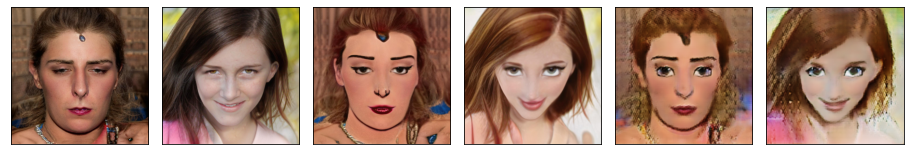


Epoch 5/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07926386528112607, 'D_fake': 0.07870945338474493}


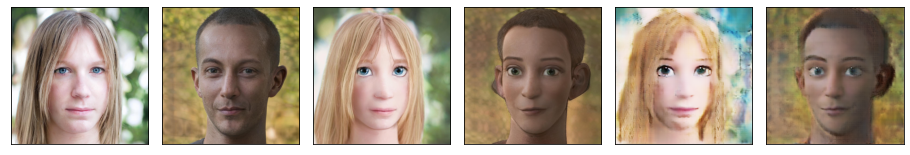


Epoch 6/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07979454167004352, 'D_fake': 0.07872390145537993}


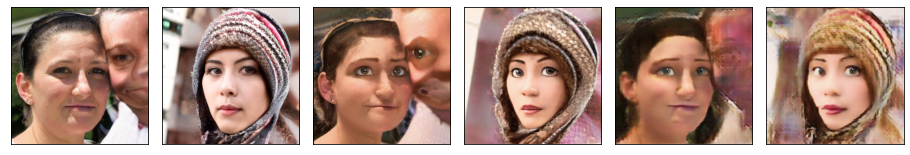


Epoch 7/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07919803323100862, 'D_fake': 0.07867148406293294}


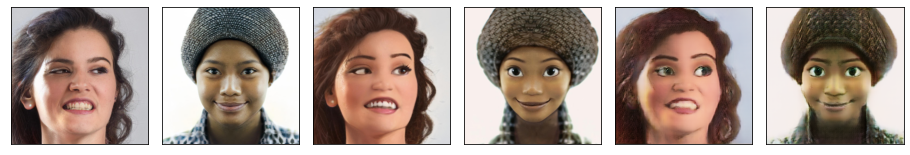


Epoch 8/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07950573838762429, 'D_fake': 0.07870021782237101}


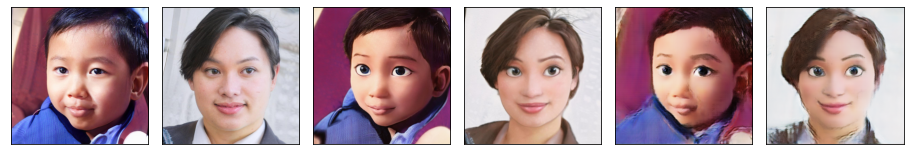


Epoch 9/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07951127971016449, 'D_fake': 0.07880176737964086}


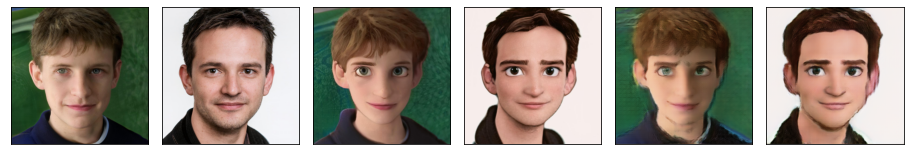


Epoch 10/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07987552429932131, 'D_fake': 0.07889679535696087}


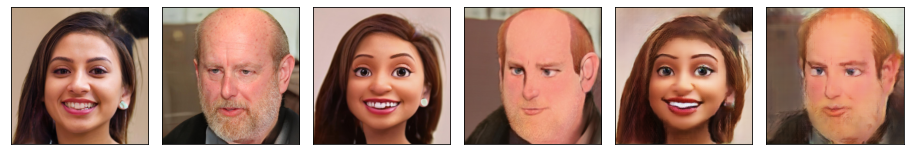


Epoch 11/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07982984215199743, 'D_fake': 0.07912174625254181}


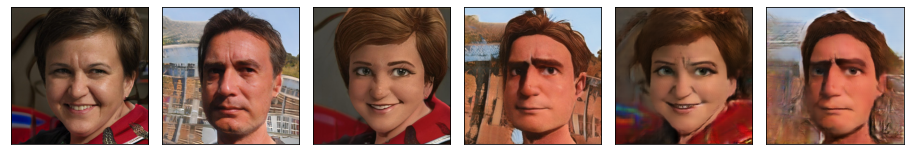


Epoch 12/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07953172158364837, 'D_fake': 0.07916426533390875}


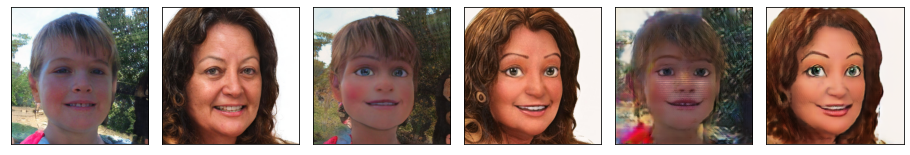


Epoch 13/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07975117835433107, 'D_fake': 0.07905015022574699}


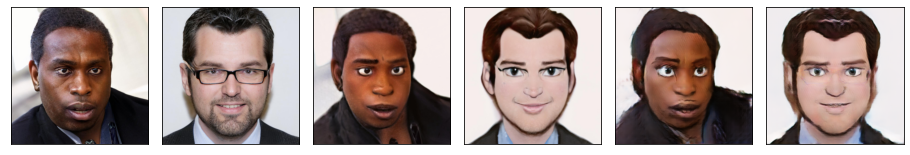


Epoch 14/39
----------


100%|██████████| 876/876 [10:56<00:00,  1.34it/s]


train Loss: {'D_real': 0.07974315869098861, 'D_fake': 0.0789904357189287}


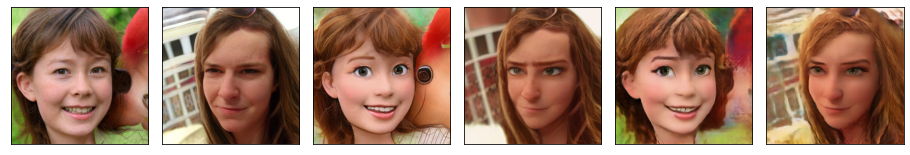


Epoch 15/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07938289521559733, 'D_fake': 0.07876602826495421}


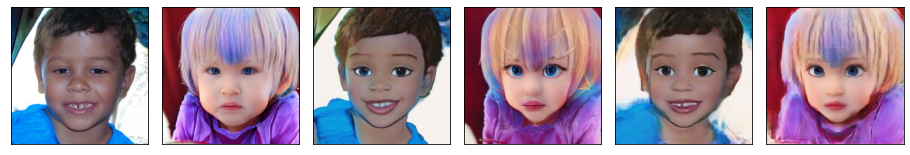


Epoch 16/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07935351560521683, 'D_fake': 0.07879516173188136}


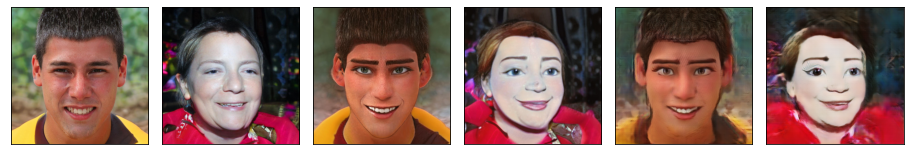


Epoch 17/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07926331316950182, 'D_fake': 0.07852770496993304}


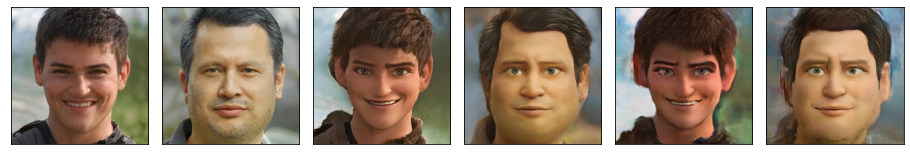


Epoch 18/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07860094000113337, 'D_fake': 0.0778083856340889}


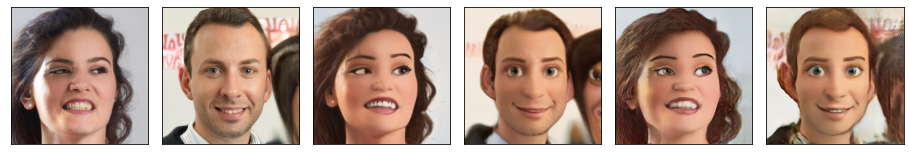


Epoch 19/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07820587572492829, 'D_fake': 0.07741405565682884}


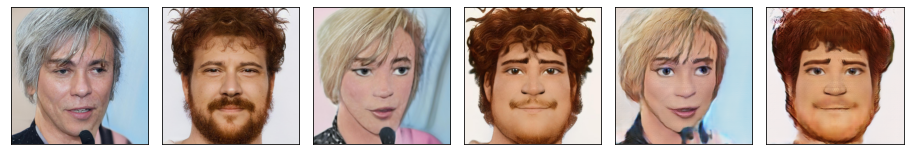


Epoch 20/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07804774825108242, 'D_fake': 0.07720314677311405}


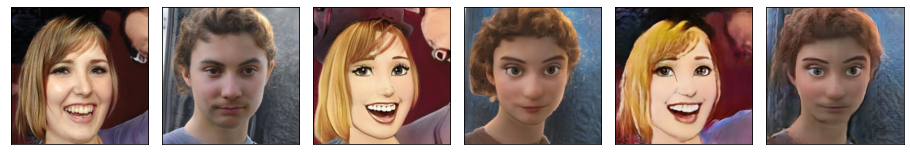


Epoch 21/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07843198590023129, 'D_fake': 0.07811522797456003}


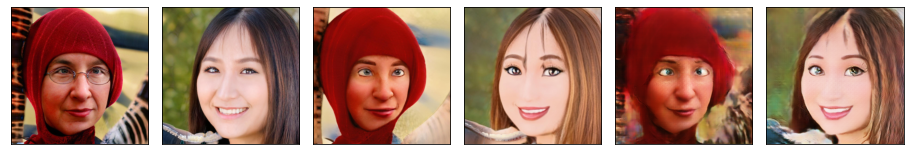


Epoch 22/39
----------


100%|██████████| 876/876 [10:56<00:00,  1.34it/s]


train Loss: {'D_real': 0.07719552583278042, 'D_fake': 0.07655187479760413}


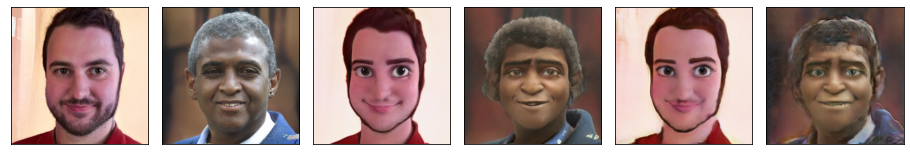


Epoch 23/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07775819999884524, 'D_fake': 0.07709710167074517}


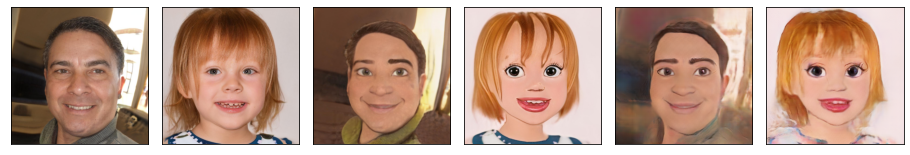


Epoch 24/39
----------


100%|██████████| 876/876 [10:56<00:00,  1.34it/s]


train Loss: {'D_real': 0.07708847548676544, 'D_fake': 0.07641924334026567}


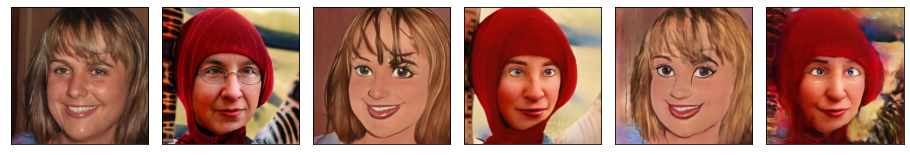


Epoch 25/39
----------


100%|██████████| 876/876 [10:56<00:00,  1.34it/s]


train Loss: {'D_real': 0.07413284602834413, 'D_fake': 0.07376912581525981}


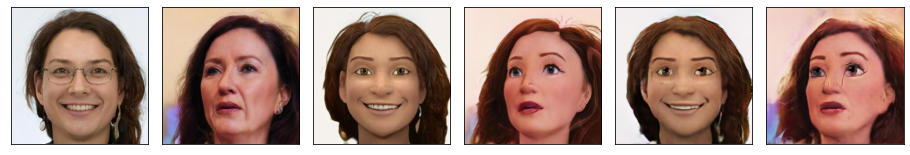


Epoch 26/39
----------


100%|██████████| 876/876 [10:56<00:00,  1.33it/s]


train Loss: {'D_real': 0.07247557733250468, 'D_fake': 0.07208718117071342}


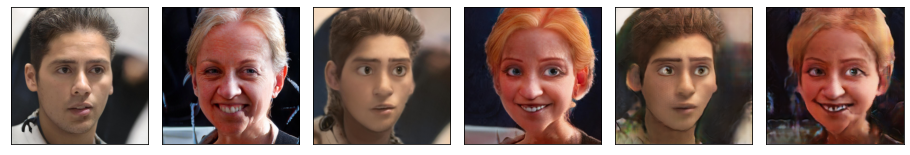


Epoch 27/39
----------


100%|██████████| 876/876 [10:55<00:00,  1.34it/s]


train Loss: {'D_real': 0.07513689939740655, 'D_fake': 0.07472983386248486}


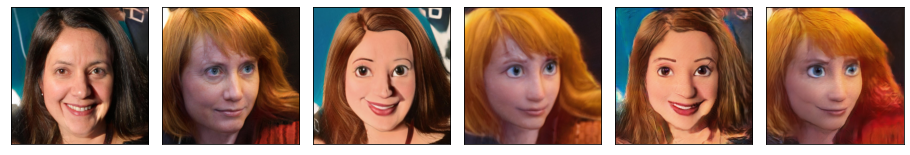


Epoch 28/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07248780274227874, 'D_fake': 0.07211938767043287}


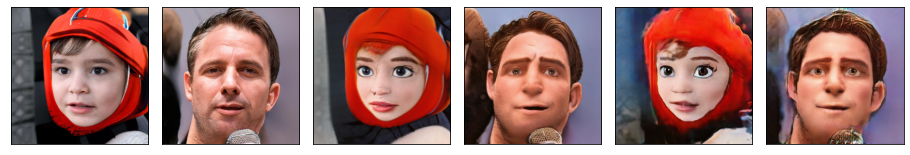


Epoch 29/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07555591812799578, 'D_fake': 0.07490901577979599}


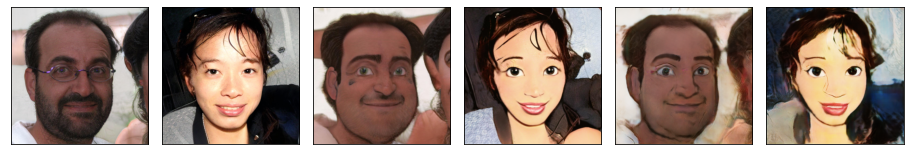


Epoch 30/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07437077141154268, 'D_fake': 0.073839165910347}


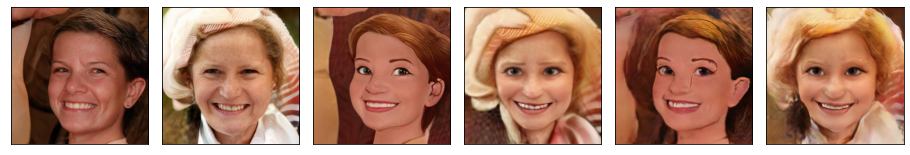


Epoch 31/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07395169599041275, 'D_fake': 0.07325579363376447}


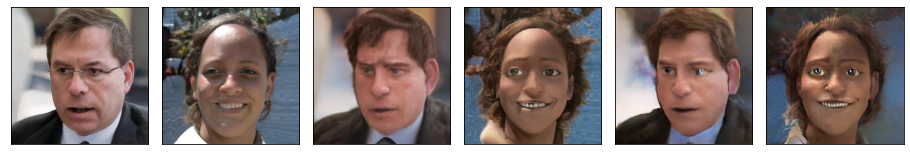


Epoch 32/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07341725520628024, 'D_fake': 0.073012759917539}


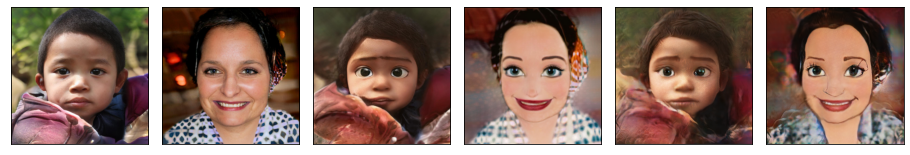


Epoch 33/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07817842297204962, 'D_fake': 0.07920597324394472}


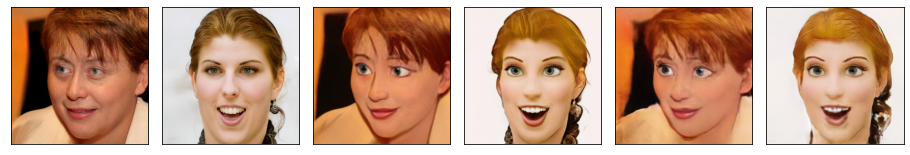


Epoch 34/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07175076198785409, 'D_fake': 0.07115933401340015}


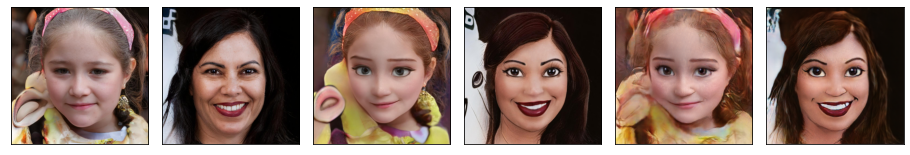


Epoch 35/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.08033826289120126, 'D_fake': 0.08139978212912537}


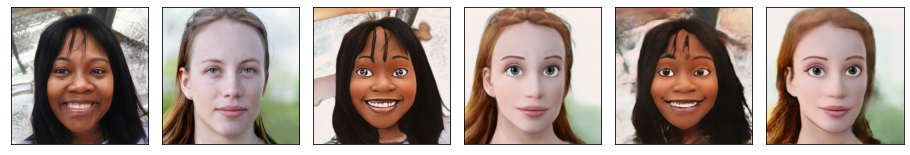


Epoch 36/39
----------


100%|██████████| 876/876 [10:54<00:00,  1.34it/s]


train Loss: {'D_real': 0.07486460563730976, 'D_fake': 0.07411689471164251}


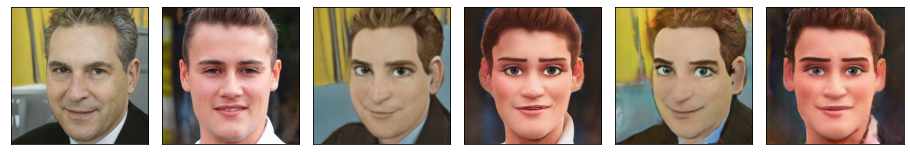


Epoch 37/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07339589295857778, 'D_fake': 0.07306249482880377}


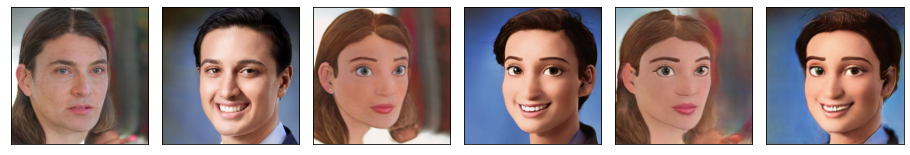


Epoch 38/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07539503900206661, 'D_fake': 0.07488625031815135}


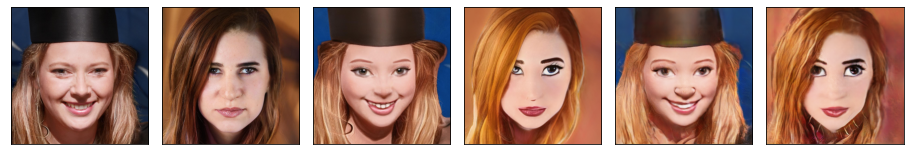


Epoch 39/39
----------


100%|██████████| 876/876 [10:53<00:00,  1.34it/s]


train Loss: {'D_real': 0.07428524062062984, 'D_fake': 0.07399151824014984}


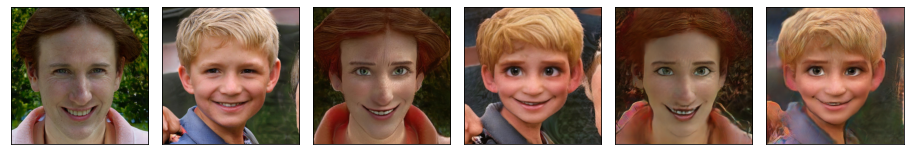

In [ ]:
loss_history, cer_history = train_model(model, train_loader, test_loader, bce, l1_loss, optimizer, None, 40)

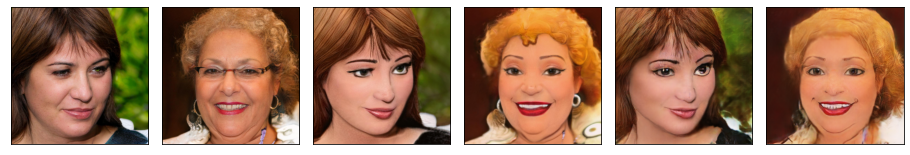

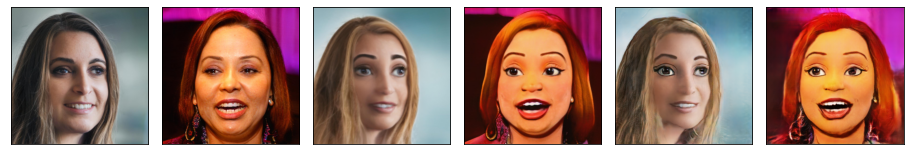

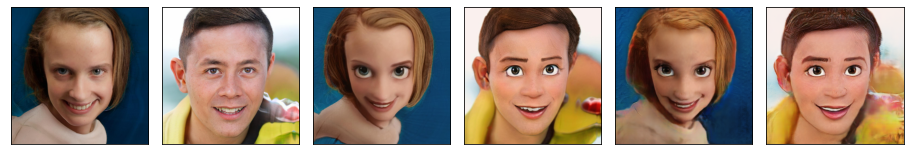

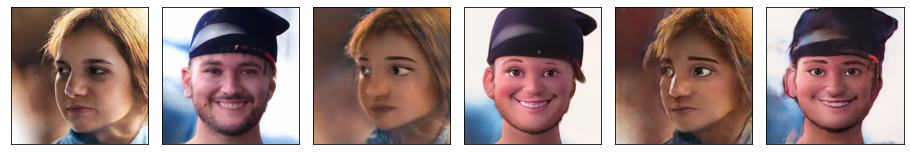

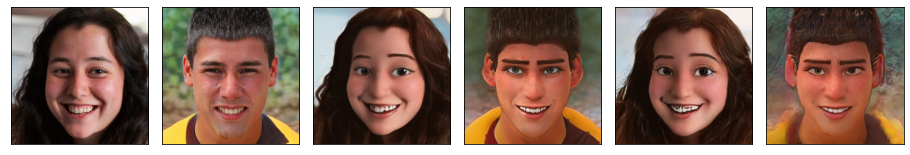

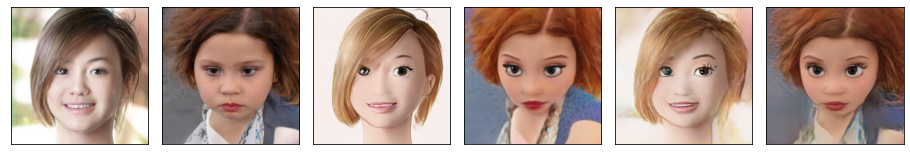

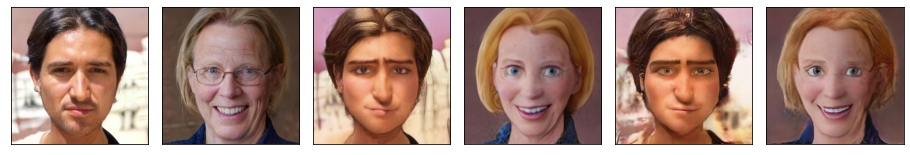

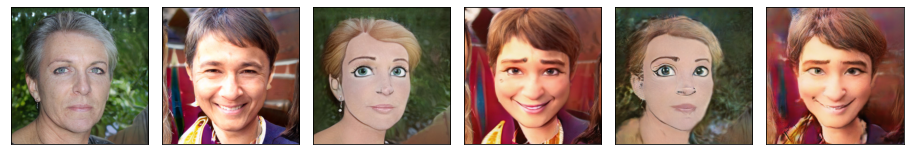

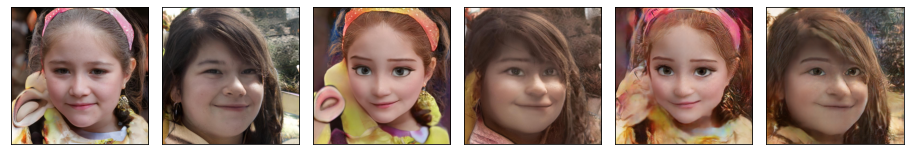

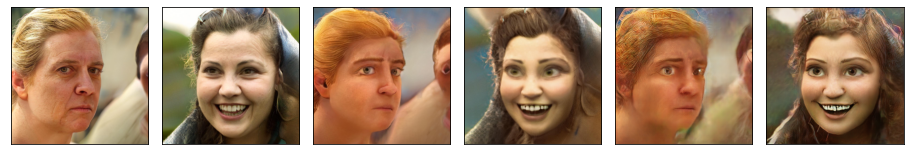

In [ ]:
for i in range(10):
  show_random_predict(model, test_loader)